In [1]:
import glob
import statmorph
import photutils
import numpy as np
import pandas as pd
import astropy.units as u
from astropy.io import fits
import scipy.ndimage as ndi
from astropy.wcs import WCS
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.colors import LogNorm
from astropy.nddata import Cutout2D
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy.convolution import Gaussian2DKernel
from astropy.stats import gaussian_fwhm_to_sigma
from matplotlib.patches import Rectangle, Ellipse, Circle
from astropy.visualization import simple_norm, ZScaleInterval, MinMaxInterval
from astropy.visualization.mpl_normalize import ImageNormalize
from astropy.visualization.stretch import LinearStretch, LogStretch, SqrtStretch
from statmorph.utils.image_diagnostics import make_figure
import warnings
from astropy.wcs import FITSFixedWarning
warnings.filterwarnings('ignore', category=FITSFixedWarning)
from astropy.coordinates import Angle
from mpl_toolkits.axes_grid1 import make_axes_locatable
from astropy.cosmology import FlatLambdaCDM
from regions import PixCoord
from regions import CircleAnnulusSkyRegion, CircleAnnulusPixelRegion
from regions import CircleSkyRegion, CirclePixelRegion
from ast import literal_eval
cosmo = FlatLambdaCDM(H0=70, Om0=0.3, Tcmb0=2.725)
import matplotlib
plt.style.use(['science'])
import pickle
from astropy.wcs.utils import skycoord_to_pixel
import ast
from matplotlib import animation
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from pylab import figure, cm
from image_processing import snr_rms
from image_processing import read_fits
from os.path import exists
plt.rcParams.update({'figure.max_open_warning': 1000})

In [2]:
# Catalog folder
sparcs_catalog = "/Users/arames52/Dropbox (ASU)/Primary Project/Multiwavelength_bcg/IRAC/catalog/"
irac_catalog = "/Users/arames52/Desktop/Primary Project/Multiwavelength_bcg/IRAC/catalog/"

# Sparcs Catalog column names

sparcs_columns = ["RA","DEC","APMAG_176","EAPMAG_176","APMAG_366","EAPMAG_366","MAG_BEST","EMAG_BEST","CH1BF","C1EBAP","C1_EPXAPC","C13PXERR","CH2BF","C2EBAP","C2_3PXAPC","C2_3PXERR" ]

In [3]:
# Normalize 2D array
def normalize_2d(matrix):
    norm = np.linalg.norm(matrix)
    matrix = matrix/norm  # normalized matrix
    return matrix

In [4]:
# IMFIT region
df = pd.read_csv("imfit_regions.csv")
df2 = pd.read_csv("/Users/arames52/Research/Data/imfit_region.csv", names = ['BCG', 'coords'])
# Maximum recoverable scale
with open("mrs.pkl", 'rb') as f:
    mrs_dict = pickle.load(f)

In [5]:
# Aperture photometry
from photutils.aperture import SkyCircularAperture
from photutils.aperture import aperture_photometry

def alma_photometry(file):
    # CoG
    h,d,w = read_fits(file, 'alma')
    position = SkyCoord(ra = h['CRVAL1']*u.deg, dec = h['CRVAL2']*u.deg, frame = 'fk5')
    radius_list = np.array([0.5, 1, 1.5, 2,2.5,3])*u.arcsec
    apertures = [SkyCircularAperture(position, r=r) for r in radius_list]
    pix_aperture = [aperture.to_pixel(w) for aperture in apertures]
    phot_table = aperture_photometry(d, pix_aperture)
    for col in phot_table.colnames:
        phot_table[col].info.format = '%.8g'  # for consistent table output
    return phot_table

# for file in sorted(glob.glob(alma_path + "*.fits")):
#     print(alma_photometry(file))
#     break

In [6]:
images_path = "/Users/arames52/Dropbox (ASU)/Primary Project/CASA Imaging/MS_files/tclean_output/"
image_type = ['briggs_05/', 'natural/', 'tapered_07arcsec/', 'tapered/', 'tapered_2arcsec/', 'tapered_3arcsec/']
ax_titles = ['briggs, r=0.5', 'natural', 'uvtaper=0.7"', 'uvtaper=1"', 'uvtaper=2"', 'uvtaper=3"']

In [10]:
# bcgs = sorted(['CDFS-18', 'CDFS19', 'ES1-12', 'ES1-26', 'ES1-35', 'XMM-19', 'XMM-27', 'ES1-18', 'ES1-25', 
#         'ES1_z_0.88', 'ES1_z_0.99', 'ES1_z_0.99b', 'ES1_z_1.60', 'XMM-11', 'XMM-29', 'XMM-30', 'XMM_113', 
#         'XMM_z_0.81', 'XMM_z_0.9', 'XMM_z_1.0', 'ES1-34', 'ES1_z_1.04', 'ES1_z_1.38', 
#         'ES1_z_1.70', 'ES1_z_1.65'])
contour_steps = {'CDFS-18':30, 'CDFS19':1, 'ES1-12':1,'ES1-26':1, 'ES1-35':1, 'XMM-19':1, 'XMM-27':1,
                'ES1-18':1, 'ES1-25':1, 'ES1_z_0.88':1, 'ES1_z_0.99':1, 'ES1_z_0.99b':1, 
                'ES1_z_1.60':1, 'XMM-11':1, 'XMM-29':1, 'XMM-30':1,'XMM-113':1, 'XMM_z_0.81':1, 
                'XMM_z_0.9':1, 'XMM_z_1.0':1, 'ES1-34':2, 'ES1_z_1.04':2, 'ES1_z_1.38':2, 'ES1_z_1.40':2,
                'ES1_z_1.70':4, 'ES1_z_1.65':10}
bcgs = ['CDFS-18','CDFS19','ES1-18','ES1-25','ES1_z_0.99','ES1_z_0.99b','ES1_z_1.04','ES1_z_1.38','ES1_z_1.60','ES1_z_1.65','ES1_z_1.70','XMM-113','XMM-11','XMM-29','XMM-30','XMM_z_0.81','XMM_z_0.9', 'XMM_z_1.0']

In [13]:
imfit_region = df
updated_imfit = df2
imfit_dict = {}
for row in updated_imfit.iterrows():
    imfit_dict[row[1].values[0]] = ast.literal_eval(row[1].values[1])
from image_processing import snr_rms
def bcg_imaging_visualization(bcg):
    fig,ax = plt.subplots(2,3, dpi = 500)
    ax = ax.ravel()
    for img_type, i in zip(image_type, range(len(image_type))):
        file = images_path + img_type + bcg + "_" + img_type.split("/")[0] + ".fits"
        h,d,w = read_fits(file, 'alma')
        c1,c2 = h['CRPIX1'],h['CRPIX2']
        xlim = (c1-9/0.045, c1+9/0.045)
        ylim = (c2-9/0.045, c2+9/0.045)
        d[d<0] = 0
        d = normalize_2d(d)
        
        im_data = imfit_dict[bcg]
        imfit_data = ast.literal_eval(imfit_region[imfit_region['BCG'] == bcg][img_type.split("/")[0]].values[0])
        r = im_data[2]/0.045
        i_r = im_data[3]/0.045
        o_r = im_data[4]/0.045
        snr, rms = snr_rms(d, (c1,c2), r, i_r, o_r)
        levels = np.arange(rms*3, rms*snr,contour_steps[bcg]*rms, dtype=None)
        x,y = w.world_to_pixel(SkyCoord(im_data[0], im_data[1], unit = 'deg'))
        region_pix = CirclePixelRegion(center=PixCoord(x=x, y=y),radius=r)
        rms_1 = CirclePixelRegion(center=PixCoord(x=x, y=y),radius=i_r)
        rms_2 = CirclePixelRegion(center=PixCoord(x=x, y=y),radius=o_r)
        mrs_pix = CirclePixelRegion(center=PixCoord(x=c1, y=c2),radius=mrs_dict[bcg]/0.045)
        
        norm = ImageNormalize(d, stretch=SqrtStretch(), interval = MinMaxInterval())
        ax[i].contour(d, levels = levels, colors='red', linewidths = 0.2, zorder = 1, alpha = 1)
        ax[i].imshow(d, origin = 'lower', cmap = 'Greys_r', norm=norm, interpolation = 'gaussian')
        ax[i].set_xlim(xlim)
        ax[i].set_ylim(ylim)
        ax[i].set_title(ax_titles[i], fontsize = 8)
        ax[i].scatter(c1,c2, marker = '+', color='cyan', s = 2, linewidth = 0.3)
        region_pix.plot(ax=ax[i], facecolor='none', edgecolor='cyan', lw=0.5, alpha = 1, ls = 'dashed', label = 'imfit region')
        rms_1.plot(ax=ax[i], facecolor='none', edgecolor='purple', lw=0.5, alpha = 1, ls = 'dashed', label = 'rms region')
        rms_2.plot(ax=ax[i], facecolor='none', edgecolor='purple', lw=0.5, alpha = 1, ls = 'dashed', label = 'rms region')
        mrs_pix.plot(ax=ax[i], facecolor='none', edgecolor='white', lw=0.5, alpha = 1, label = 'rms region')
    for a in ax:
        a.set_xticks([])
        a.set_yticks([])
    fig.suptitle(bcg, size = 5)
    fig.savefig("/Users/arames52/Research/Results/bcg_imaging_visualization/" + bcg + ".jpg", dpi = 500)

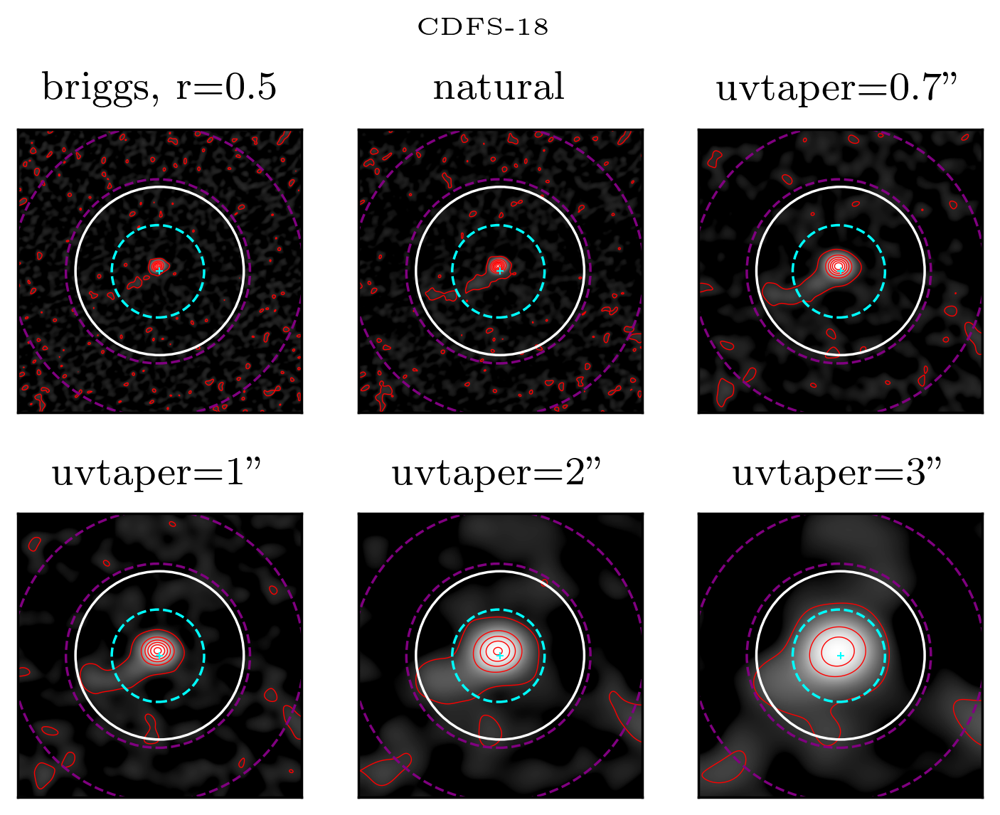

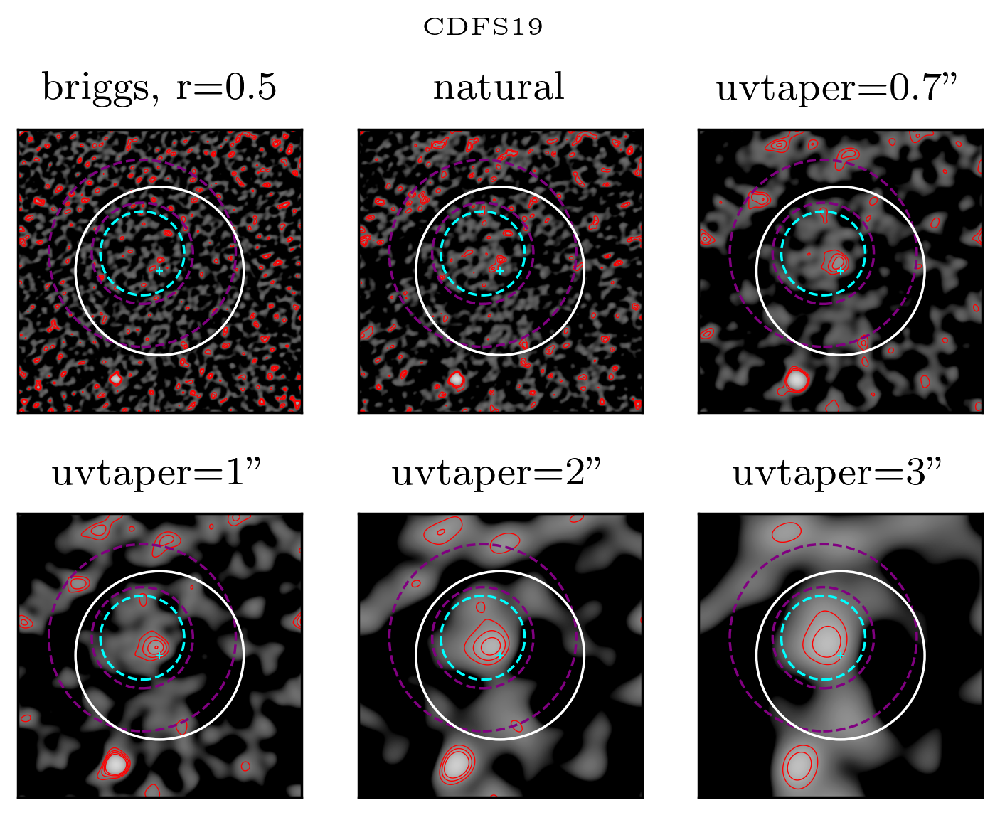

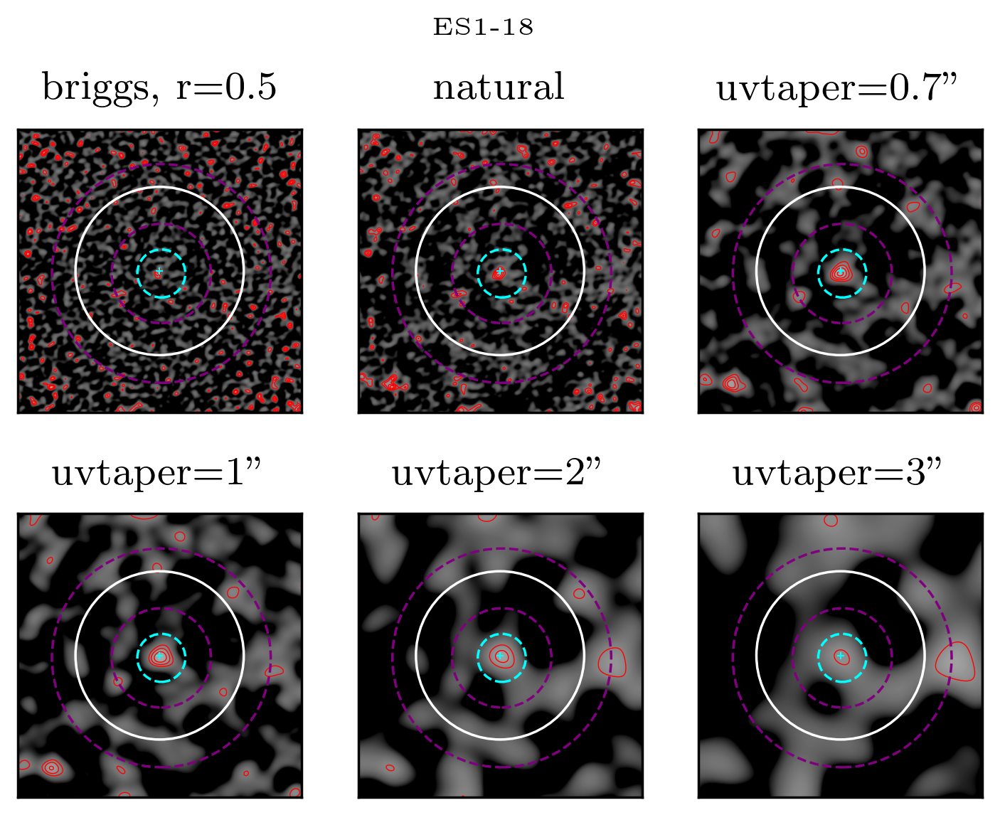

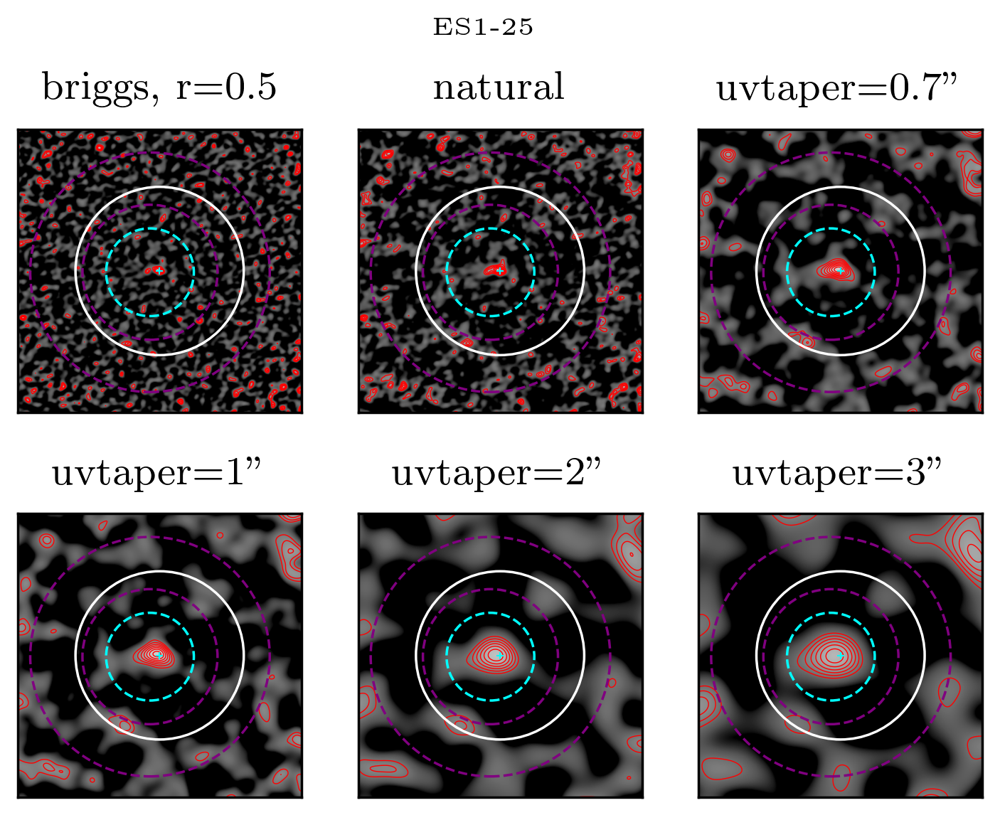

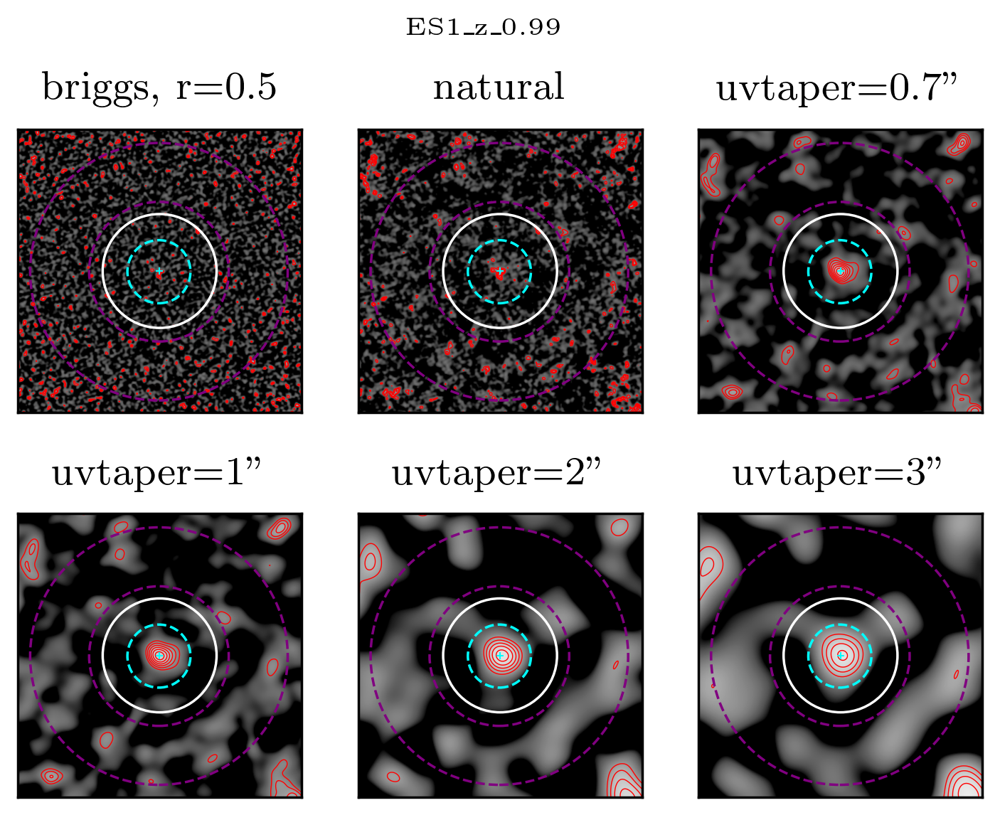

...

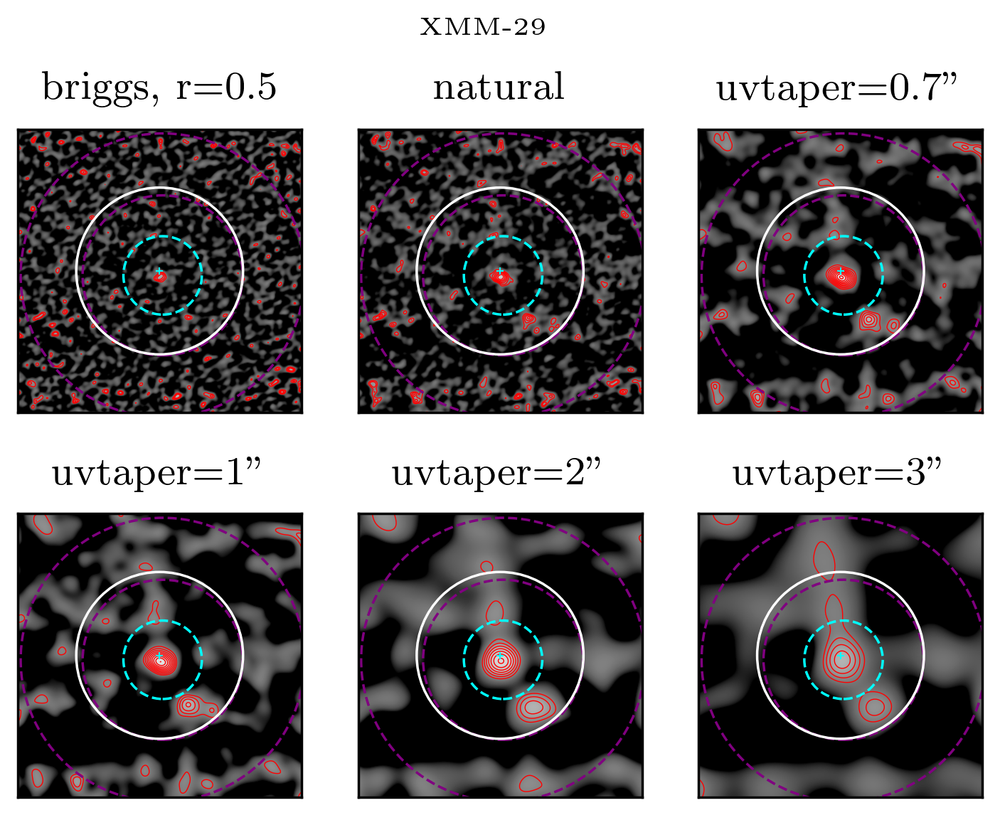

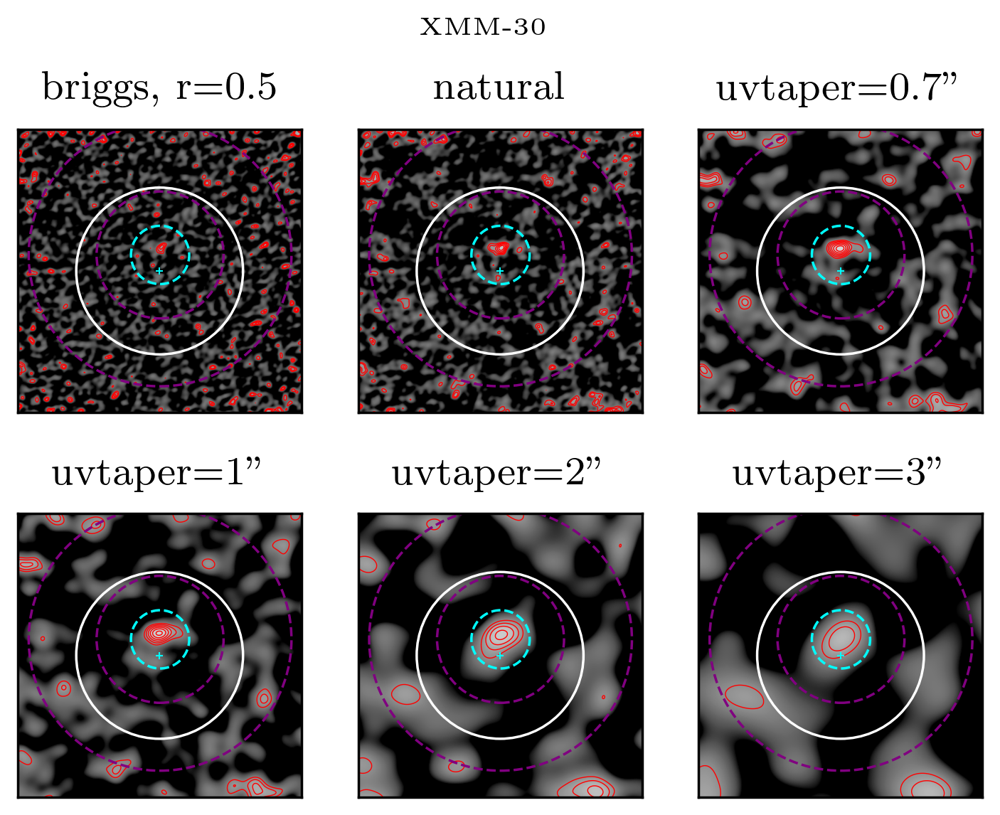

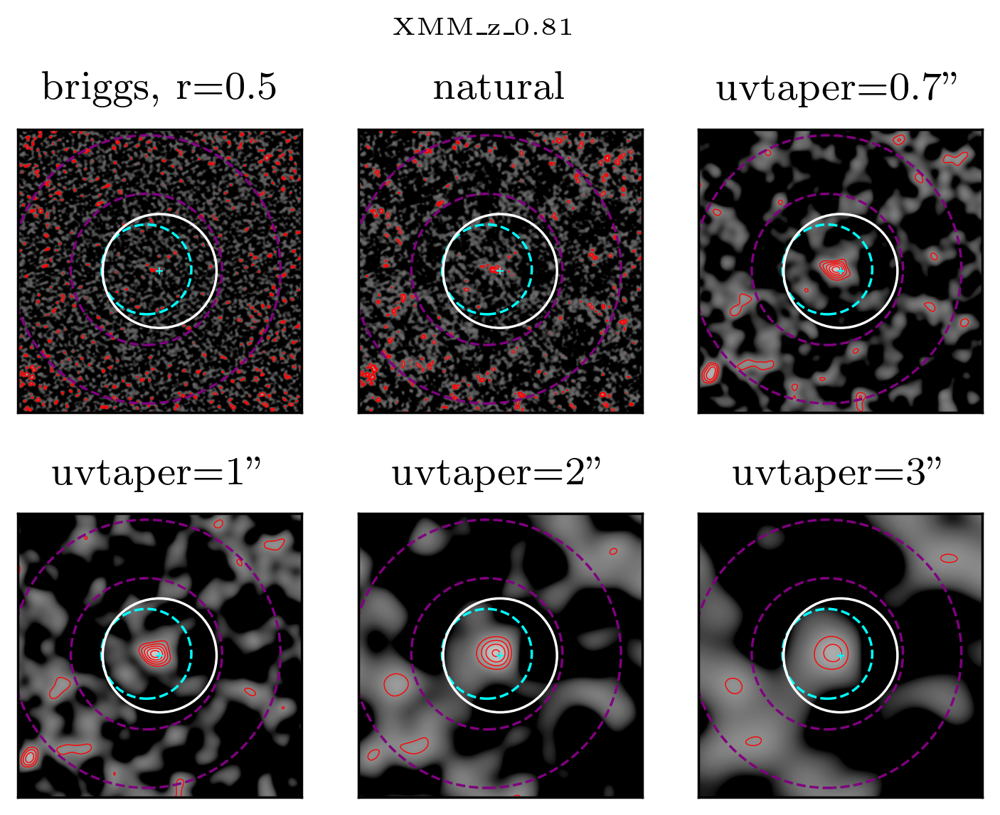

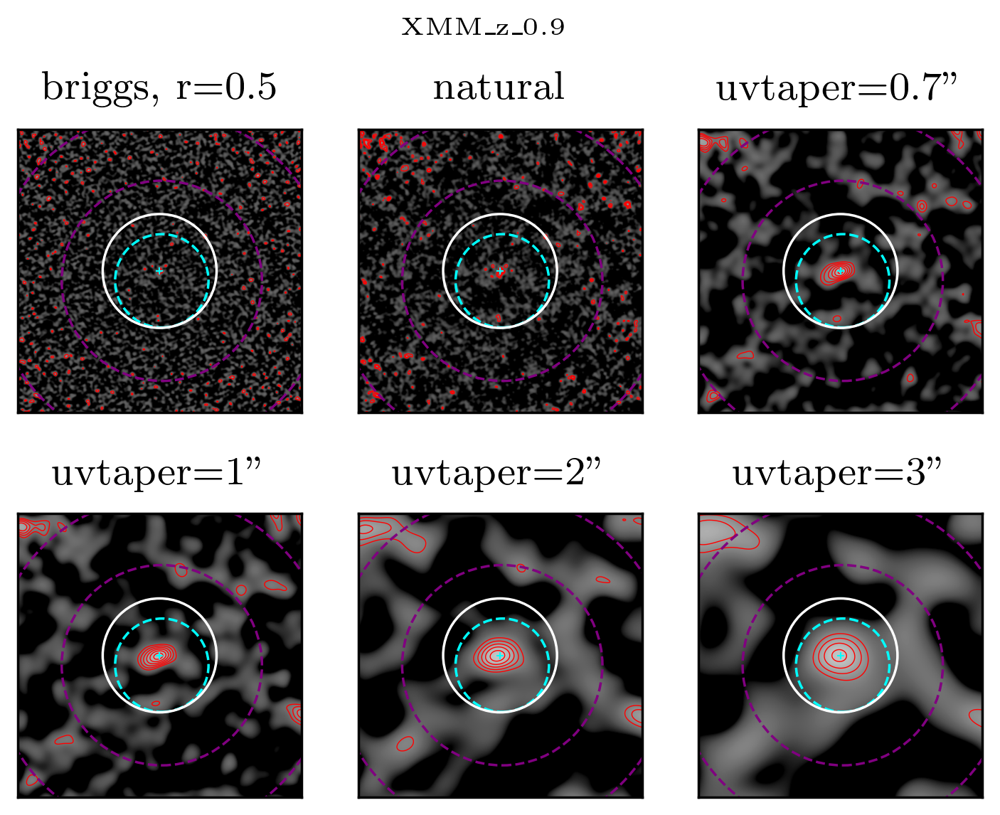

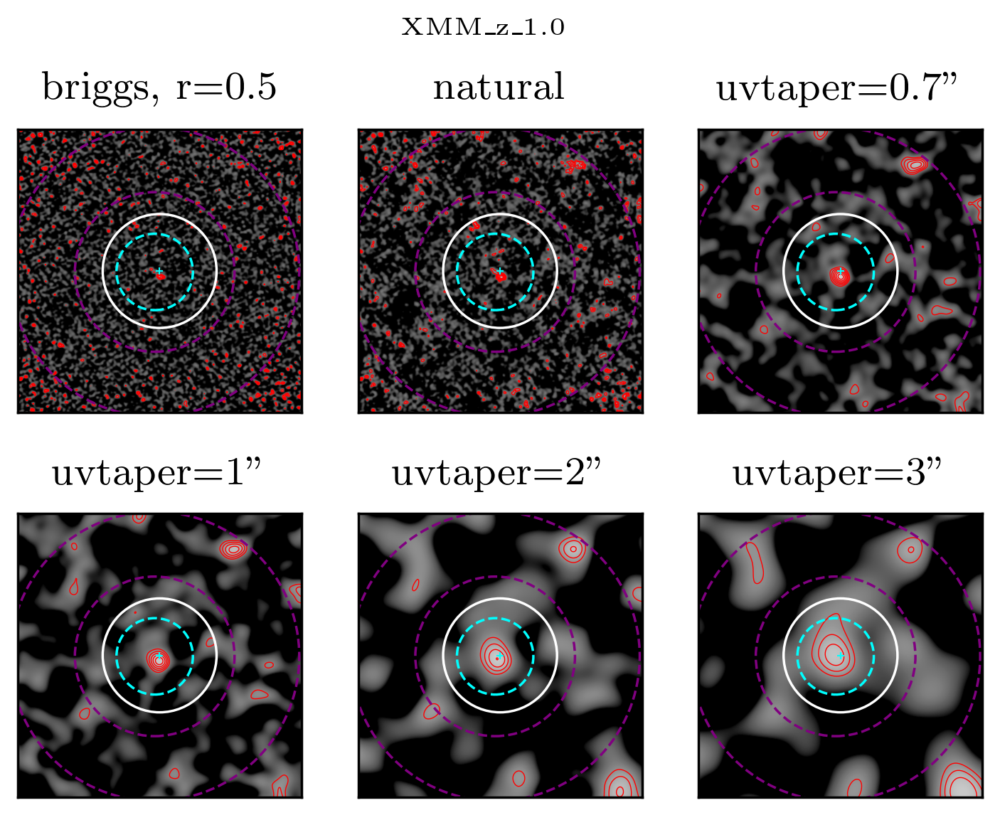

In [14]:
for bcg in bcgs:
    bcg_imaging_visualization(bcg)

In [31]:
# from photutils.aperture import CircularAperture, ApertureStats
# BCG Multiwavelength postage stamps with nearby sources


mw_path = '/Users/arames52/Dropbox (ASU)/Primary Project/CASA Imaging/MW_bcgs/'
wave_type = ['SpARCS_z/', 'irac_3.6_micron/', 'mips_24_micron/', 'ALMA/']
file_suffix= [".fits", '_3.6micron.fits','_24micron.fits', '_natural.fits']
from image_processing import snr_rms
def mw_postage_stamps(bcg):
    
    z_h,z_d,z_w = read_fits(mw_path + wave_type[0] + bcg + file_suffix[0])
    irac_h,irac_d,irac_w = read_fits(mw_path + wave_type[1] + bcg + file_suffix[1])
    mips_h,mips_d,mips_w = read_fits(mw_path + wave_type[2] + bcg + file_suffix[2])
    alma_h,alma_d,alma_w = read_fits(mw_path + wave_type[3] + bcg + file_suffix[3], 'alma')
    
    z_d = np.nan_to_num(normalize_2d(z_d))
    irac_d = np.nan_to_num(normalize_2d(irac_d))
    mips_d = np.nan_to_num(normalize_2d(mips_d))
    alma_d = np.nan_to_num(normalize_2d(alma_d))
    
    fig = plt.figure(dpi = 500, figsize = (15,5))
    ax1 = fig.add_subplot(141, projection=alma_w)
    ax2 = fig.add_subplot(142, projection=alma_w,sharey=ax1)
    ax3 = fig.add_subplot(143, projection=alma_w,sharey=ax1)
    ax4 = fig.add_subplot(144, projection=alma_w,sharey=ax1)
    
    ra, dec = alma_h['CRVAL1'], alma_h['CRVAL2']
    c = SkyCoord(ra, dec, frame = 'fk5', unit = 'deg')
    centerpix = alma_w.world_to_pixel(c)
    
    xlim = (centerpix[0]-9/0.045, centerpix[0]+9/0.045)
    ylim = (centerpix[1]-9/0.045, centerpix[1]+9/0.045)
    
    z_trans = ax1.get_transform(z_w)
    irac_trans = ax2.get_transform(irac_w)
    mips_trans = ax3.get_transform(mips_w)
    
    if bcg.startswith("CDFS"):
        i_cat = pd.read_csv(irac_catalog + "cdfs_irac.csv")
        z_cat = pd.read_csv(sparcs_catalog + "CDFS_zIRAC_simple.lst", delim_whitespace=True, names = sparcs_columns, comment = '#')
    elif bcg.startswith("ES1"):
        i_cat = pd.read_csv(irac_catalog + "es1_irac.csv")
        z_cat = pd.read_csv(sparcs_catalog + "ELAISS1_zIRAC_simple.lst", delim_whitespace=True, names = sparcs_columns, comment = '#')
    elif bcg.startswith("XMM"):
        i_cat = pd.read_csv(irac_catalog + "xmm_irac.csv")
        z_cat = pd.read_csv(sparcs_catalog + "XMM-LSS_zIRAC_simple.lst", delim_whitespace=True, names = sparcs_columns, comment = '#')
     

    i_cat = i_cat.reset_index(drop = True)
    z_cat = z_cat.reset_index(drop = True)
    
    irac_cat = SkyCoord(ra=np.array(i_cat['ra'])*u.deg, dec = np.array(i_cat['dec'])*u.deg, frame = 'fk5')
    d2d_irac = c.separation(irac_cat)
    msk_irac = d2d_irac < 6*u.arcsec
    idx_irac = np.where(msk_irac)[0]
    
    zband_cat = SkyCoord(ra=np.array(z_cat['RA'])*u.deg, dec = np.array(z_cat['DEC'])*u.deg, frame = 'fk5')
    d2d_z= c.separation(zband_cat)
    msk_z = d2d_z < 6*u.arcsec
    idx_z = np.where(msk_z)[0]
    
    irac_sources = irac_cat[idx_irac]
    z_sources = zband_cat[idx_z]
    
    region_pix = CirclePixelRegion(center=PixCoord(x=centerpix[0], y=centerpix[1]),radius=6/0.045)
    mrs_region = CirclePixelRegion(center=PixCoord(x=centerpix[0], y=centerpix[1]),radius=mrs_dict[bcg]/0.045)
    
    aperture = SkyCircularAperture(c, r=6*u.arcsec)
    z_aper = aperture.to_pixel(z_w)
    irac_aper = aperture.to_pixel(irac_w)
    mips_aper = aperture.to_pixel(mips_w)
    alma_aper = aperture.to_pixel(alma_w)
    vmax_list = []
    for aper,data in zip([z_aper, irac_aper, mips_aper, alma_aper], [z_d, irac_d, mips_d, alma_d]):
        x = round(aper.positions[0])
        y = round(aper.positions[1])
        r = round(aper.r)
        imin = x - r
        imax = x + r + 1
        jmin = y - r
        jmax = y + r + 1
        circle = []
        for i in np.arange(imin, imax).astype(int):
            for j in np.arange(jmin, jmax).astype(int):
                ij = np.array([i,j])
                dist = np.linalg.norm(ij - np.array((x,y)))
                circle.append(data[i][j])
        circle = np.array(circle)
        vmax = np.max(circle)
        vmax_list.append(vmax)
    
    if bcg == 'CDFS-18':
        alma_vmax = 0.01
    else:
        alma_vmax = vmax_list[3]
    def plot_norm(data):
        return ImageNormalize(data, stretch=LinearStretch(), interval = ZScaleInterval())
    
    imfit_data = ast.literal_eval(imfit_region[imfit_region['BCG'] == bcg]['natural'].values[0])
    r = imfit_data[2]/0.045
    i_r = imfit_data[3]/0.045
    o_r = imfit_data[4]/0.045
    snr, rms = snr_rms(alma_d, centerpix, r, i_r, o_r)
    levels = np.arange(rms*3, rms*snr,contour_steps[bcg]*rms, dtype=None)
    
    ax1.contour(alma_d, levels = levels, colors='cyan', linewidths = 0.5, zorder = 1, alpha = 1)
    im1 = ax1.imshow(z_d, transform = z_trans, origin = 'lower', interpolation='none',cmap = 'hot', vmin = 0, vmax = vmax_list[0])
    ax1.scatter(centerpix[0], centerpix[1], marker = 'o', color = 'green', s = 3, label = 'BCG')
    for coord in z_sources:
        pix1, pix2 = skycoord_to_pixel(coord, alma_w)
        ax1.scatter(pix1, pix2, marker = 'x', color = 'blue', s = 40, label = 'Optical Sources')
    ax2.contour(alma_d, levels = levels, colors='cyan', linewidths = 0.5, zorder = 1, alpha = 1)
    im2 = ax2.imshow(irac_d, transform = irac_trans, origin = 'lower', interpolation='none',cmap = 'hot', vmin=0, vmax = vmax_list[1])
    ax2.scatter(centerpix[0], centerpix[1], marker = 'o', color = 'green', s = 3, label = 'BCG')
    for coord in irac_sources:
        pix1,pix2 = skycoord_to_pixel(coord, alma_w)
        ax2.scatter(pix1,pix2, marker = 'x', color = 'blue', s = 40)
    ax3.contour(alma_d, levels = levels, colors='cyan', linewidths = 0.5, zorder = 1, alpha = 1)
    im3 = ax3.imshow(mips_d, transform = mips_trans, origin = 'lower', interpolation='none',cmap = 'hot', vmin = 0, vmax = vmax_list[2])
    ax3.scatter(centerpix[0], centerpix[1], marker = 'o', color = 'green', s = 3, label = 'BCG')
    ax4.contour(alma_d, levels = levels, colors='cyan', linewidths = 0.5, zorder = 1, alpha = 1)
    im4 = ax4.imshow(alma_d, origin = 'lower', interpolation='none',cmap = 'hot', vmin = 0, vmax = alma_vmax)
    ax4.scatter(centerpix[0], centerpix[1], marker = 'o', color = 'green', s = 3, label = 'BCG')
    patch1 = mrs_region.plot(ax=ax4, facecolor='none', edgecolor='white', lw=0.5, ls = 'dashed')
    
    from astropy.wcs.utils import proj_plane_pixel_scales as ps
    
    ax1.set_xlim(xlim)
    ax1.set_ylim(ylim)
    ax2.set_xlim(xlim)
    ax2.set_ylim(ylim)
    ax3.set_xlim(xlim)
    ax3.set_ylim(ylim)
    ax4.set_xlim(xlim)
    ax4.set_ylim(ylim)
    
    ax1.coords[1].set_ticks_visible(False)
    ax1.coords[1].set_ticklabel_visible(False)
    ax2.coords[1].set_ticks_visible(False)
    ax2.coords[1].set_ticklabel_visible(False)
    ax3.coords[1].set_ticks_visible(False)
    ax3.coords[1].set_ticklabel_visible(False)
    ax4.coords[1].set_ticks_visible(False)
    ax4.coords[1].set_ticklabel_visible(False)
    ax1.coords[0].set_ticks_visible(False)
    ax1.coords[0].set_ticklabel_visible(False)
    ax2.coords[0].set_ticks_visible(False)
    ax2.coords[0].set_ticklabel_visible(False)
    ax3.coords[0].set_ticks_visible(False)
    ax3.coords[0].set_ticklabel_visible(False)
    ax4.coords[0].set_ticks_visible(False)
    ax4.coords[0].set_ticklabel_visible(False)
    ax1.set_title("SpARCS z-band")
    ax2.set_title("IRAC 3.6$\mu$m")
    ax3.set_title("MIPS 24$\mu$m")
    ax4.set_title("ALMA")
    fig.suptitle(bcg + " Contours:" + str(contour_steps[bcg]) + "$\sigma$ steps (" + str(round(rms*1000, 3)) + " mJy)", x=0.5, y = 0.85)
    fig.colorbar(im1, ax = ax1,fraction=0.046)
    fig.colorbar(im2, ax = ax2,fraction=0.046)
    fig.colorbar(im3, ax = ax3,fraction=0.046)
    fig.colorbar(im4, ax = ax4,fraction=0.046)
#     fig.savefig("/Users/arames52/Desktop/Plots/MW_postage_stamps/" + bcg + ".jpg", dpi = 500)

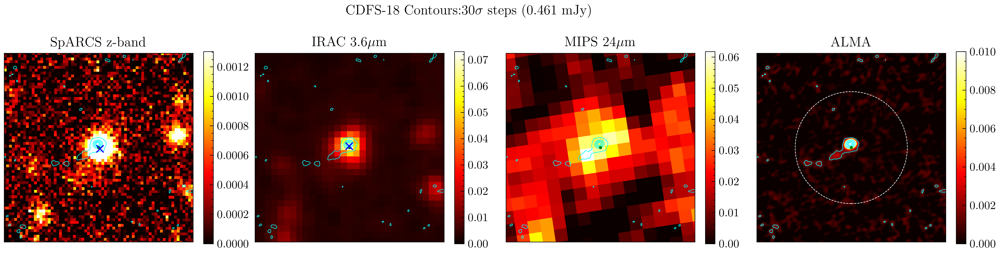

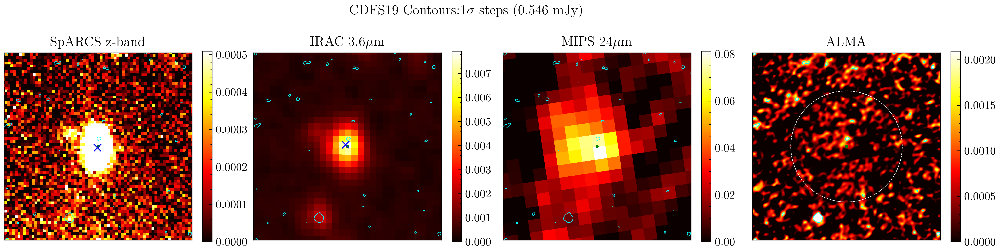

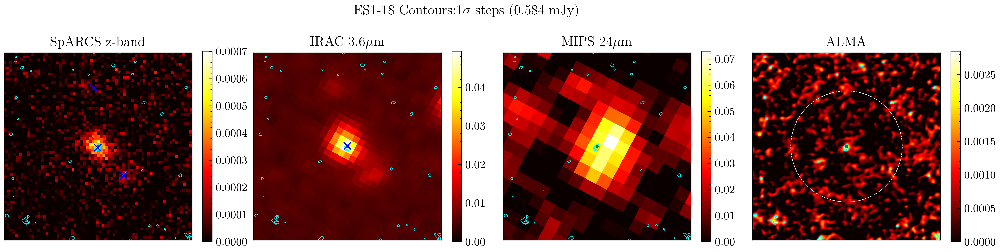

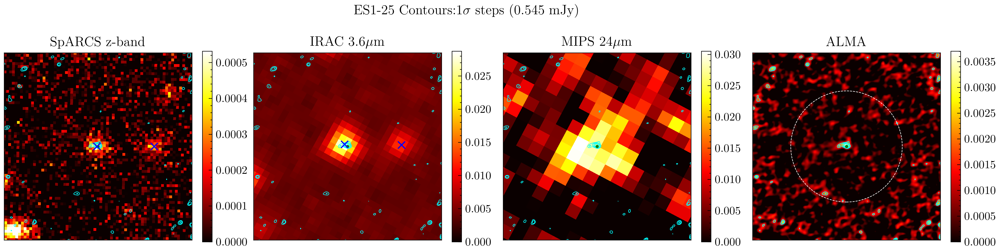

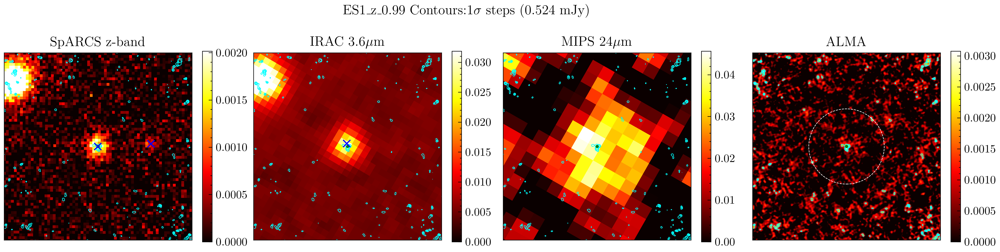

...

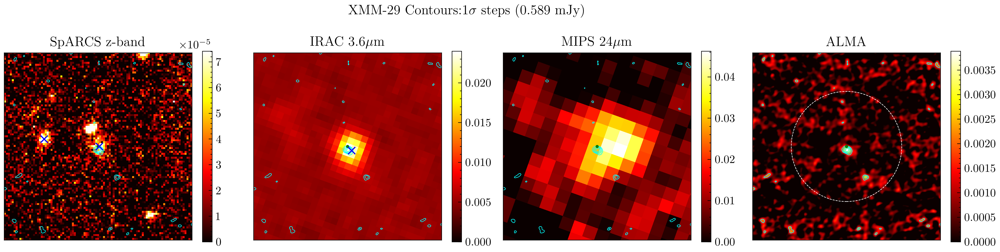

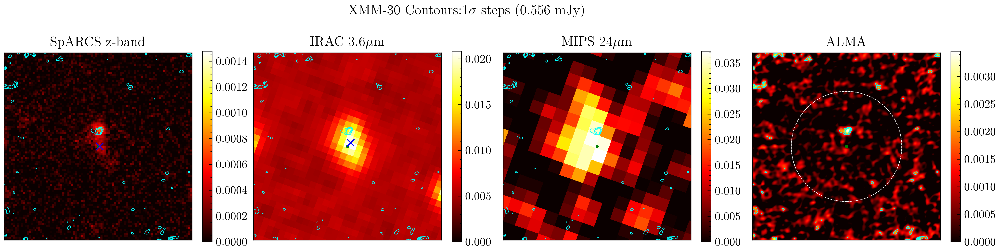

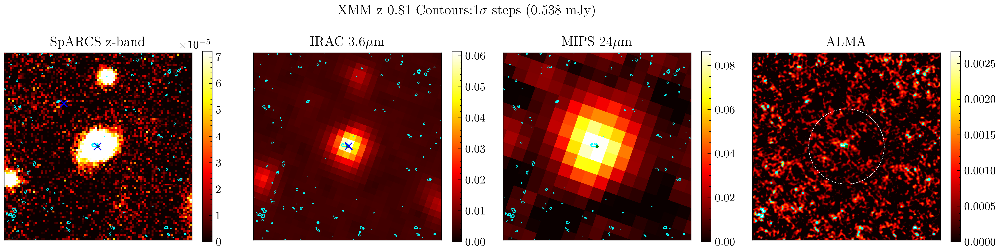

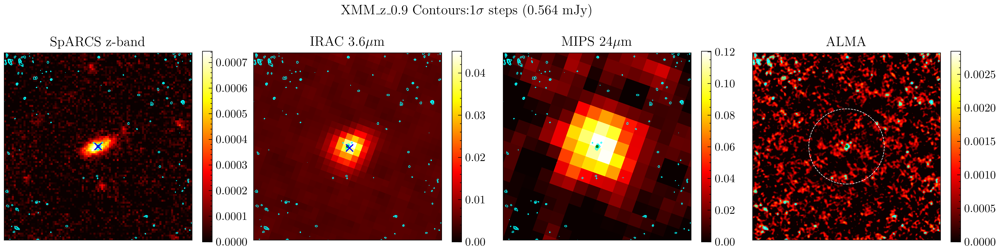

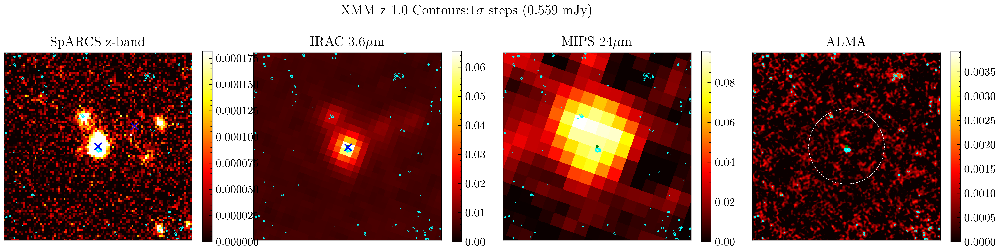

In [57]:
bcgs = ['CDFS-18','CDFS19','ES1-18','ES1-25','ES1_z_0.99','ES1_z_0.99b','ES1_z_1.04','ES1_z_1.38','ES1_z_1.60','ES1_z_1.65','ES1_z_1.70','XMM-113','XMM-11','XMM-29','XMM-30','XMM_z_0.81','XMM_z_0.9', 'XMM_z_1.0']
for bcg in bcgs:
    mw_postage_stamps(bcg)

In [21]:
with open("/Users/arames52/Research/Codes/CASA_codes/imfit_results_.pkl", "rb") as f:
    imfit_results = pickle.load(f)

In [24]:
with open("imfit_results.pkl", "rb") as f:
    imfit_prev = pickle.load(f)

In [37]:
id_ = ['ES1_z_0.99', 'XMM-11']
weight = ['natural', 'briggs_05', 'tapered_07arcsec', 'tapered']
weight_ = ['natural','briggs', '0.7_taper', '1_taper']

In [38]:
for bcg in id_:
    for w,w_ in zip(weight, weight_):
        imfit_results[w_][bcg] = imfit_prev[w][bcg]

In [39]:
len(bcgs)

18

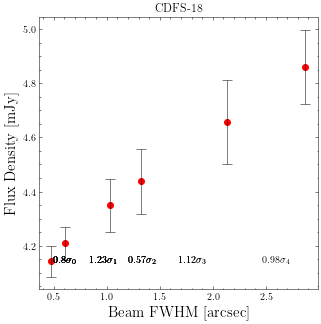

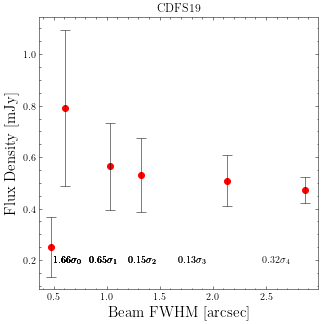

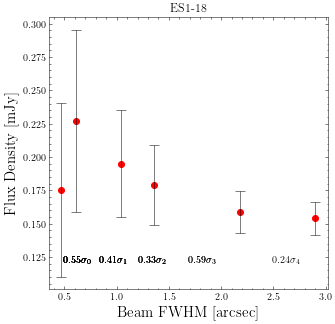

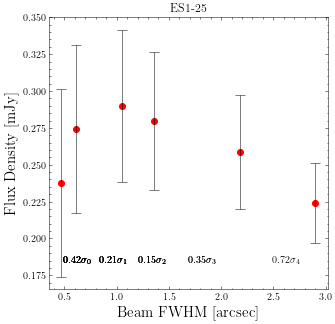

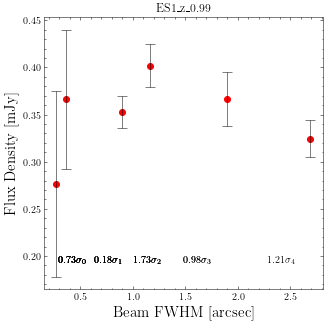

...

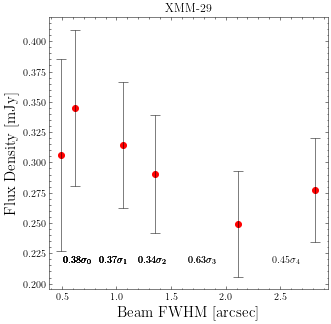

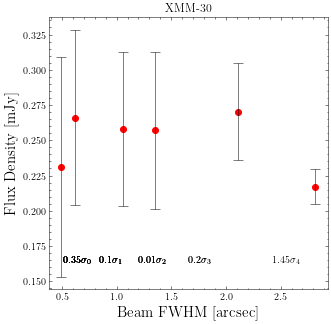

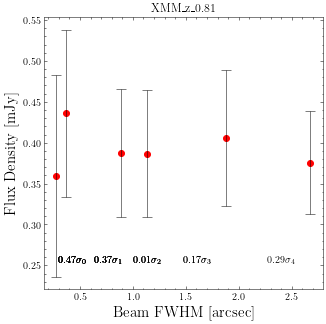

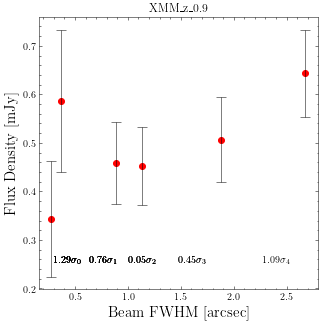

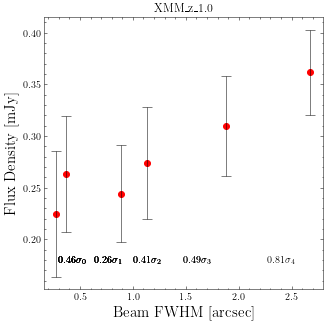

In [40]:
for bcg in bcgs:
    fwhm = []
    flux = []
    error = []
    fig,ax = plt.subplots(1,1, figsize = (5,5))
    for w in  imfit_results.keys():
        imfit_dict = imfit_results[w][bcg]['deconvolved']['component0']
        # if w in ["tapered_2arcsec", "tapered_3arcsec"]:
        #     flux.append(imfit_results[w][bcg]['results']['component0']['peak']['value'])
        #     error.append(imfit_results[w][bcg]['results']['component0']['peak']['error'])
        # else:
        flux.append(imfit_dict['flux']['value'][0])
        error.append(imfit_dict['flux']['error'][0])
        fwhm.append(imfit_results[w][bcg]['results']['component0']['beam']['beamarcsec']['major']['value'])

    flux_diff = []
    flux = np.array(flux)*1000
    error = np.array(error)*1000
    ax.scatter(fwhm, flux, color = 'red')
    ax.set_title(bcg)
    ax.errorbar(fwhm, flux, yerr = error,ls = 'none', ecolor = 'black', alpha = 0.5,solid_capstyle='projecting', capsize=5, elinewidth = 1)
    flux_difference = []
    for i in range(0,6):
        if i+1 >= 6:
            continue
        else:
            quad_err = np.sqrt(error[i]**2 + error[i+1]**2)
            fd = np.abs((flux[i+1]-flux[i]))/quad_err
            flux_diff.append(fd)

        str_i = str(i)
        text = str(round(fd,2)) + "$\sigma_" + str_i + "$"
        flux_difference.append(text)
        for text, x_pos in zip(flux_difference, np.array([0.05, 0.18, 0.32, 0.5, 0.8])):
            ax.text(x = x_pos, y = 0.1, s = text,transform=ax.transAxes)
    ax.set_xlabel('Beam FWHM [arcsec]', size = 15)
    ax.set_ylabel('Flux Density [mJy]',size = 15)
    # plt.show()
#     fig.savefig("/Users/arames52/Desktop/Plots/check/" + bcg + "_fb.jpg", dpi = 300)

In [33]:
imfit_prev.keys()

dict_keys(['natural', 'briggs_05', 'tapered_07arcsec', 'tapered', 'tapered_2arcsec', 'tapered_3arcsec'])

In [41]:
previous_sed_path = "/Users/arames52/Downloads/cigale-v2020.0/pcigale/data/"

In [43]:
# fig,ax = plt.subplots(1,1, dpi = 200)
# for bcg in bcgs:
#     df = pd.read_csv(previous_sed_path + bcg + "/" + "flux_table.csv")
#     columns = df.columns
#     current_flux = imfit_results['natural'][bcg]['deconvolved']['component0']['flux']['value'][0]
#     error = imfit_results['natural'][bcg]['deconvolved']['component0']['flux']['error'][0]
#     previous_flux = pd.read_csv(previous_sed_path + bcg + "/" + "flux_table.csv").iloc[:,-2].values[0]
#     df[columns[-2]] = round(current_flux*1000,3)
#     df[columns[-1]] = round(error*1000,3)
#     df.to_csv(previous_sed_path + bcg + "/" + "flux_table.csv")
#     ax.scatter(previous_flux, current_flux*1000, marker = 'x', color = 'red', s = 5, lw = 0.5)
# #     text = bcg
# #     ax.text(x = previous_flux, y = current_flux*1000, s = text, size=5)
#     print(bcg, round(current_flux*1000,3), round(error*1000, 3), previous_flux)
# lims = [
# np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
# np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
#     ]
# ax.plot(lims, lims, ':', color = 'black',alpha=0.75, zorder=0)
# ax.set_xlabel("Previous flux")
# ax.set_ylabel("Current flux")

In [123]:
%store -r table

In [124]:
table

,id,redshift,SFR,SFR_err,Stellar_mass,Stellar_mass_err,sSFR,sSFR_err
0,CDFS-18,0.807580,23.774215,4.575206,1.537039e+11,1.513251e+10,1.546754e-10,3.343551e-11
1,CDFS-19,0.694840,33.475627,4.083425,1.555707e+11,1.086400e+10,2.151794e-10,3.024499e-11
2,ES1-18,0.806800,38.188351,4.061975,1.639990e+11,1.767912e+10,2.328572e-10,3.526445e-11
3,ES1-25,1.088070,35.366280,20.081889,1.124729e+11,2.073930e+10,3.144428e-10,1.877272e-10
4,ES1_z_0.99,1.193720,489.013575,94.498574,6.014814e+10,5.900599e+09,8.130152e-09,1.761952e-09
5,ES1_z_0.99b,0.918860,36.012544,11.712387,7.190383e+10,2.427103e+10,5.008432e-10,2.347635e-10
6,ES1_z_1.04,1.040000,114.083693,45.640634,1.202538e+11,7.776155e+09,9.486910e-10,3.844618e-10
7,ES1_z_1.38,1.380000,762.108290,178.498955,1.233143e+11,1.143310e+10,6.180212e-09,1.556798e-09
8,ES1_z_1.60,1.600000,283.258496,122.437134,1.965026e+11,1.020404e+10,1.441500e-09,6.275619e-10
9,ES1_z_1.65,1.650000,1308.716465,98.934307,2.807570e+11,2.801558e+10,4.661385e-09,5.835495e-10


In [115]:
table['sSFR_gyr'] = table['sSFR']*1e9
table['sSFR_err_gyr'] = table['sSFR_err']*1e9
from astropy.cosmology import FlatLambdaCDM
cosmo = FlatLambdaCDM(H0=70, Om0=0.3, Tcmb0=2.725)
table['Age'] = cosmo.age(table['redshift'])
table['sSFR_MS'] = 26 * table['Age']**(-2.2)

In [116]:
bcg_type = []
for ind,row in table.iterrows():
    if row['sSFR_gyr'] < row['sSFR_MS']/2:
        bcg_type.append(0)
    elif (row['sSFR_gyr'] > row['sSFR_MS']/2) & (row['sSFR_gyr'] < row['sSFR_MS']*2):
        bcg_type.append(1)
    elif (row['sSFR_gyr'] > row['sSFR_MS']*2):
        bcg_type.append(2)
table['bcg_type'] = bcg_type

In [117]:
redshift = np.array(table['redshift'])
subMS = np.array(bcg_type) == 0
MS = np.array(bcg_type) == 1
SB = np.array(bcg_type) == 2

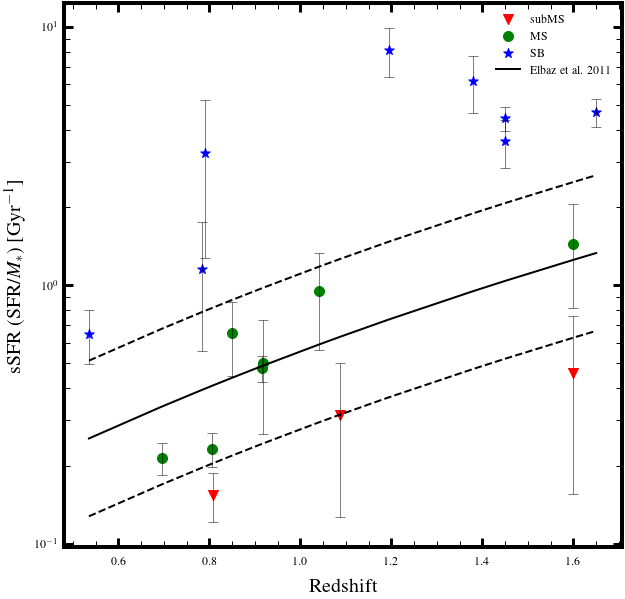

In [118]:
plt.style.use("/Users/arames52/Dropbox (ASU)/Primary Project/End-to-end flow BCGs/stylesheet.txt")
fig,ax = plt.subplots(1,1, figsize = (10,10))
vmin, vmax = min(redshift), max(redshift)
ax.scatter(redshift[subMS], table['sSFR_gyr'][subMS], color = "red", marker = "v", label = 'subMS')
ax.scatter(redshift[MS], table['sSFR_gyr'][MS], color = "green", marker = "o", label = 'MS')
ax.scatter(redshift[SB], table['sSFR_gyr'][SB], color = "blue", marker = "*", label = 'SB')
ax.errorbar(redshift, table['sSFR_gyr'], yerr = table['sSFR_err_gyr'], ls = 'none', ecolor = 'black', alpha = 0.5,solid_capstyle='projecting', capsize=5, elinewidth = 1)
ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']), color = 'black', linewidth = 2, label = 'Elbaz et al. 2011')
ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']*2), color = 'black', ls = "--", linewidth = 2)
ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']/2), color = 'black', ls = "--", linewidth = 2)
# ax.set_xscale("log")
ax.set_yscale("log")
ax.set_ylabel("sSFR (SFR/$M_*$) [Gyr$^{-1}$]")
ax.set_xlabel("Redshift")
ax.legend()
# ax.grid()
# divider = make_axes_locatable(ax)
# cax = divider.append_axes('right', size="7%", pad=0.2)
# cbar = fig.colorbar(im, cax=cax);
# cbar.ax.set_ylabel('redshift')
# plt.savefig("/Users/arames52/Desktop/ssfr_z.jpg", dpi = 300)

In [120]:
table

,id,redshift,SFR,SFR_err,Stellar_mass,Stellar_mass_err,sSFR,sSFR_err,sSFR_gyr,sSFR_err_gyr,Age,sSFR_MS,bcg_type
0,CDFS-18,0.807580,23.774215,4.575206,1.537039e+11,1.513251e+10,1.546754e-10,3.343551e-11,0.154675,0.033436,6.597183,0.409623,0
1,CDFS-19,0.694840,33.475627,4.083425,1.555707e+11,1.086400e+10,2.151794e-10,3.024499e-11,0.215179,0.030245,7.189158,0.339064,1
2,ES1-18,0.806800,38.188351,4.061975,1.639990e+11,1.767912e+10,2.328572e-10,3.526445e-11,0.232857,0.035264,6.601018,0.409100,1
3,ES1-25,1.088070,35.366280,20.081889,1.124729e+11,2.073930e+10,3.144428e-10,1.877272e-10,0.314443,0.187727,5.413663,0.632838,0
4,ES1_z_0.99,1.193720,489.013575,94.498574,6.014814e+10,5.900599e+09,8.130152e-09,1.761952e-09,8.130152,1.761952,5.052398,0.736680,2
5,ES1_z_0.99b,0.918860,36.012544,11.712387,7.190383e+10,2.427103e+10,5.008432e-10,2.347635e-10,0.500843,0.234764,6.083441,0.489604,1
6,ES1_z_1.04,1.040000,114.083693,45.640634,1.202538e+11,7.776155e+09,9.486910e-10,3.844618e-10,0.948691,0.384462,5.591708,0.589353,1
7,ES1_z_1.38,1.380000,762.108290,178.498955,1.233143e+11,1.143310e+10,6.180212e-09,1.556798e-09,6.180212,1.556798,4.502037,0.949453,2
8,ES1_z_1.60,1.600000,283.258496,122.437134,1.965026e+11,1.020404e+10,1.441500e-09,6.275619e-10,1.441500,0.627562,3.966461,1.254545,1
9,ES1_z_1.65,1.650000,1308.716465,98.934307,2.807570e+11,2.801558e+10,4.661385e-09,5.835495e-10,4.661385,0.583549,3.858989,1.332697,2


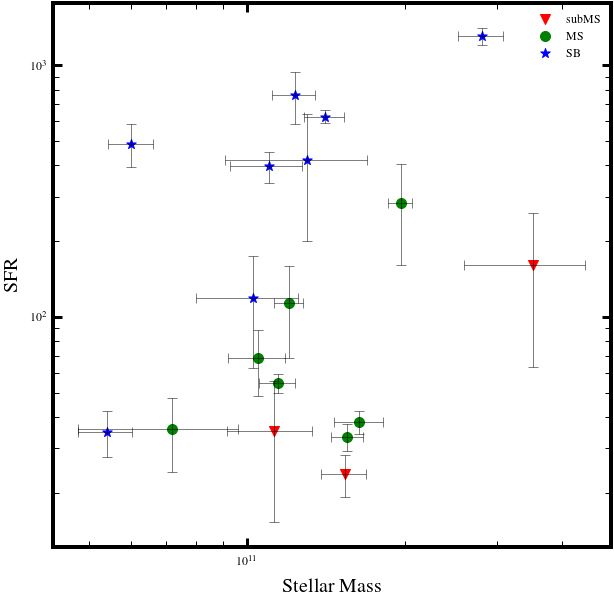

In [119]:
plt.style.use("/Users/arames52/Dropbox (ASU)/Primary Project/End-to-end flow BCGs/stylesheet.txt")
fig,ax = plt.subplots(1,1, figsize = (10,10))
vmin, vmax = min(redshift), max(redshift)
ax.scatter(table['Stellar_mass'][subMS], table['SFR'][subMS], color = "red", marker = "v", label = 'subMS')
ax.scatter(table['Stellar_mass'][MS], table['SFR'][MS], color = "green", marker = "o", label = 'MS')
ax.scatter(table['Stellar_mass'][SB], table['SFR'][SB], color = "blue", marker = "*", label = 'SB')
ax.errorbar(table['Stellar_mass'], table['SFR'], yerr = table['SFR_err'], xerr = table['Stellar_mass_err'],ls = 'none', ecolor = 'black', alpha = 0.5,solid_capstyle='projecting', capsize=5, elinewidth = 1)
# ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']), color = 'black', linewidth = 2, label = 'Elbaz et al. 2011')
# ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']*2), color = 'black', ls = "--", linewidth = 2)
# ax.plot(sorted(table['redshift']),sorted(table['sSFR_MS']/2), color = 'black', ls = "--", linewidth = 2)
ax.set_xscale("log")
ax.set_yscale("log")
ax.set_ylabel("SFR")
ax.set_xlabel("Stellar Mass")
ax.legend()

In [112]:
imfit_results["1_taper"]['ES1_z_1.04']

{'converged': array([ True]),
 'deconvolved': {'component0': {'beam': {'beamarcsec': {'major': {'unit': 'arcsec',
      'value': 1.1564480066299438},
     'minor': {'unit': 'arcsec', 'value': 1.1197737455368042},
     'positionangle': {'unit': 'deg', 'value': -73.16392517089844}},
    'beampixels': 724.59575488553,
    'beamster': 3.4488201444005076e-11},
   'flux': {'error': array([6.63585885e-05, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00]),
    'polarisation': 'Stokes',
    'unit': 'Jy',
    'value': array([0.00058526, 0.        , 0.        , 0.        ])},
   'ispoint': False,
   'label': '',
   'peak': {'error': 4.941854828148572e-05,
    'unit': 'Jy/beam',
    'value': 0.0006169861583556983},
   'shape': {'direction': {'error': {'latitude': {'unit': 'arcsec',
       'value': 0.04981930524866116},
      'longitude': {'unit': 'arcsec', 'value': 0.06735248047834025}},
     'm0': {'unit': 'rad', 'value': 0.15457176138433357},
     'm1': {'unit': 'rad', 'value': -0.737223884736597